# Rosetta Stone

In [ ]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
import seaborn as sns

import torch
import torchvision
from torchvision import transforms

In [3]:
import os

os.chdir('/notebooks/compexp/vision/')
print(os.getcwd())

import sys

sys.path.append('./my')
from rosettastone import maxact

sys.path.append('')
import settings
from loader.model_loader import loadmodel

/notebooks/compexp/vision
result/alexnet_places365_broden_ade20k_neuron_3


In [4]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [5]:
from rosettastone.disentanglement import disentangle_cnn

import wandb

In [24]:
NEURON = 171

In [6]:
wandb.login()

wandb: Currently logged in as: shlomihod (use `wandb login --relogin` to force relogin)


True

In [7]:
model = loadmodel(None)


def normalize_image(rgb_image):
    img = np.array(rgb_image, dtype=np.float32).copy()
    img = img[:, ::-1]
    img -= [109.5388, 118.6897, 124.6901]
    img = img.transpose((2, 0, 1))
    
    # accuracy is better without rgb -> bgr, not clear why it is necessery
    # perhaps it is necesseray for ADE20K? Don't know right now.
    # img = torch.from_numpy(img[::-1, :, :].copy())
    
    img = torch.from_numpy(img.copy())
    img = img.div_(255.0 * 0.224)
    
    return img


# preprocess = transforms.Compose([
#     transforms.Resize(224),
#     transforms.CenterCrop(224),
#     transforms.ToTensor(),
#     transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
# ])


# maxact.set_seed(42)
place365_dataset = torchvision.datasets.Places365(root='/notebooks/compexp/vision/my/data', split='val', small=True,
                                         transform=transforms.Lambda(normalize_image))
place365_dataloader = torch.utils.data.DataLoader(place365_dataset, batch_size=32, num_workers=8, shuffle=False)

In [25]:
from rosettastone.disentanglement import splitting_operation, succeeding_operation, freezer, get_named_parameters, train, evaluate

import copy
from functools import partial
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from tqdm import trange




    
class AlexDisentangleNet(nn.Module):
    def __init__(self, net, neuron, device):
        super().__init__()
        self.orig_net = copy.deepcopy(net)
        self.splitted_net = copy.deepcopy(net)
        self.neuron = neuron
        self.device = device
        self._prepare_splitted()
        self.active_net = 'orig'

        
    def _prepare_splitted(self):
        
        freezer(self.orig_net)
        freezer(self.splitted_net)

        self.splitted_net.features[10], _ = splitting_operation(self.orig_net.features[10],
                                                             self.neuron,
                                                             self.device)
        
        self.splitted_net.classifier[1], _ = succeeding_operation(self.orig_net.classifier[1],
                                                             self.neuron,
                                                             self.orig_net.features[10].out_channels,
                                                             self.device)

        self.eval()  # turn off dropout, but also BN and it is not good    
        
    def forward(self, x, active_net=None):
        if active_net is None:
            active_net = self.active_net
        assert active_net in ('orig', 'splitted')
        return self.orig_net(x) if active_net == 'orig' else self.splitted_net(x)
        
    def generate_losses(self, x_indff, xx1, xx2):
        x_orig = self.orig_net.features(x_indff)
        x_orig = self.orig_net.avgpool(x_orig)
        x_orig = torch.flatten(x_orig, 1)
        x_orig = self.orig_net.classifier[1](x_orig)

        x_splitted = self.splitted_net.features(x_indff)
        x_splitted = self.splitted_net.avgpool(x_splitted)
        x_splitted = torch.flatten(x_splitted, 1)
        x_splitted = self.splitted_net.classifier[1](x_splitted)

        return (torch.flatten(F.mse_loss(x_orig,
                                         x_splitted,
                                                 reduction='none'), 1)), 0, 0, 0, 0
                

    def equality_report(self):
        print()
        print('==', (self.orig_net.features[10].bias[:self.neuron] == self.splitted_net.features[10].bias[:self.neuron]).all())
        print('==', (self.orig_net.features[10].bias[self.neuron+1:] == self.splitted_net.features[10].bias[self.neuron+1:-1]).all())
        print('!=', (self.orig_net.features[10].bias[self.neuron] == self.splitted_net.features[10].bias[self.neuron]).all())
        print('!=', (self.orig_net.features[10].bias[self.neuron] == self.splitted_net.features[10].bias[-1]).all())
        print()
        if self.neuron:
            print('==', (self.orig_net.classifier[1].weight[:, :36*self.neuron] ==  self.splitted_net.classifier[1].weight[:, :36*self.neuron]).any())
        print('==', (self.orig_net.classifier[1].weight[:, 36*(self.neuron+1):] ==  self.splitted_net.classifier[1].weight[:, 36*(self.neuron+1):-36]).any())
        print('!=', (self.orig_net.classifier[1].weight[:, 36*self.neuron:36*(self.neuron+1)] ==  self.splitted_net.classifier[1].weight[:, 36*self.neuron:36*(self.neuron+1)]).any())
        print('!=', (self.splitted_net.classifier[1].weight[:, 36*self.neuron:36*(self.neuron+1)] ==  self.splitted_net.classifier[1].weight[:, -36:]).any())
        print('==', (self.orig_net.classifier[1].bias ==  self.splitted_net.classifier[1].bias).any())
        print()
        
        

                
with wandb.init(project='disentanglement', save_code=True):
    dnet = AlexDisentangleNet(model, NEURON, device)
    wandb.watch(dnet, log='all', log_freq=100)
    print(get_named_parameters(dnet))
    dnet.equality_report()
    train(dnet, place365_dataloader, place365_dataloader, place365_dataloader, 1, 0, 'cuda')
    dnet.equality_report()
    print(evaluate(dnet, place365_dataloader, device))

  0%|          | 0/1 [00:00<?, ?it/s]

['splitted_net.features.10.weight', 'splitted_net.features.10.bias', 'splitted_net.classifier.1.weight']

== tensor(True, device='cuda:0')
== tensor(True, device='cuda:0')
!= tensor(True, device='cuda:0')
!= tensor(True, device='cuda:0')

== tensor(True, device='cuda:0')
== tensor(True, device='cuda:0')
!= tensor(True, device='cuda:0')
!= tensor(True, device='cuda:0')
== tensor(True, device='cuda:0')

Loss after 00768 examples: 0.155
Loss after 01568 examples: 0.066
Loss after 02368 examples: 0.037
Loss after 03168 examples: 0.021
Loss after 03968 examples: 0.018
Loss after 04768 examples: 0.017
Loss after 05568 examples: 0.038
Loss after 06368 examples: 0.027
Loss after 07168 examples: 0.017
Loss after 07968 examples: 0.015
Loss after 08768 examples: 0.020
Loss after 09568 examples: 0.017
Loss after 10368 examples: 0.010
Loss after 11168 examples: 0.018
Loss after 11968 examples: 0.017
Loss after 12768 examples: 0.007
Loss after 13568 examples: 0.009
Loss after 14368 examples: 0.013
L

100%|██████████| 1/1 [01:24<00:00, 84.74s/it]


== tensor(True, device='cuda:0')
== tensor(True, device='cuda:0')
!= tensor(False, device='cuda:0')
!= tensor(False, device='cuda:0')

== tensor(True, device='cuda:0')
== tensor(True, device='cuda:0')
!= tensor(False, device='cuda:0')
!= tensor(False, device='cuda:0')
== tensor(True, device='cuda:0')



{'test_accuracy_orig': 0.45821917808219176, 'test_accuracy_splitted': 0.4583835616438356}


epoch,0
loss,0.00115
indff_loss,0.00115
spc11_loss,0.0
spc22_loss,0.0
spc12_loss,0.0
spc21_loss,0.0
_runtime,147
_timestamp,1619894915
_step,35968
test_accuracy_orig,0.45822


epoch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
loss,█▄▃▂▂▂▃▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁
indff_loss,█▄▃▂▂▂▃▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁
spc11_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
spc22_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
spc12_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
spc21_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
_runtime,▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▄▄▄▅▅▅▅█
_timestamp,▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▄▄▄▅▅▅▅█
_step,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
test_accuracy_orig,▁


In [65]:
import loader.data_loader.ade20k as ade20k# import load_ade20k, to_dataloader

In [67]:
ade20k.S2I['person']

KeyError: 'person'

In [ ]:
person, animal

In [71]:
ade20k.load_ade20k('./dataset/broden1_227/images/ade20k/')

FileNotFoundError: [Errno 2] No such file or directory: './dataset/broden1_227/images/ade20k/images/training'

## MaxAct

In [27]:
#model = loadmodel(None)


def normalize_image(rgb_image):
    img = np.array(rgb_image, dtype=np.float32).copy()
    img = img[:, ::-1]
    img -= [109.5388, 118.6897, 124.6901]
    img = img.transpose((2, 0, 1))
    
    # accuracy is better without rgb -> bgr, not clear why it is necessery
    # perhaps it is necesseray for ADE20K? Don't know right now.
    # img = torch.from_numpy(img[::-1, :, :].copy())
    
    img = torch.from_numpy(img.copy())
    img = img.div_(255.0 * 0.224)
    
    return img


# preprocess = transforms.Compose([
#     transforms.Resize(224),
#     transforms.CenterCrop(224),
#     transforms.ToTensor(),
#     transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
# ])


# maxact.set_seed(42)
place365_dataset = torchvision.datasets.Places365(root='/notebooks/compexp/vision/my/data', split='val', small=True,
                                         transform=transforms.Lambda(normalize_image))
place365_dataloader = torch.utils.data.DataLoader(place365_dataset, batch_size=32, num_workers=8, shuffle=False)


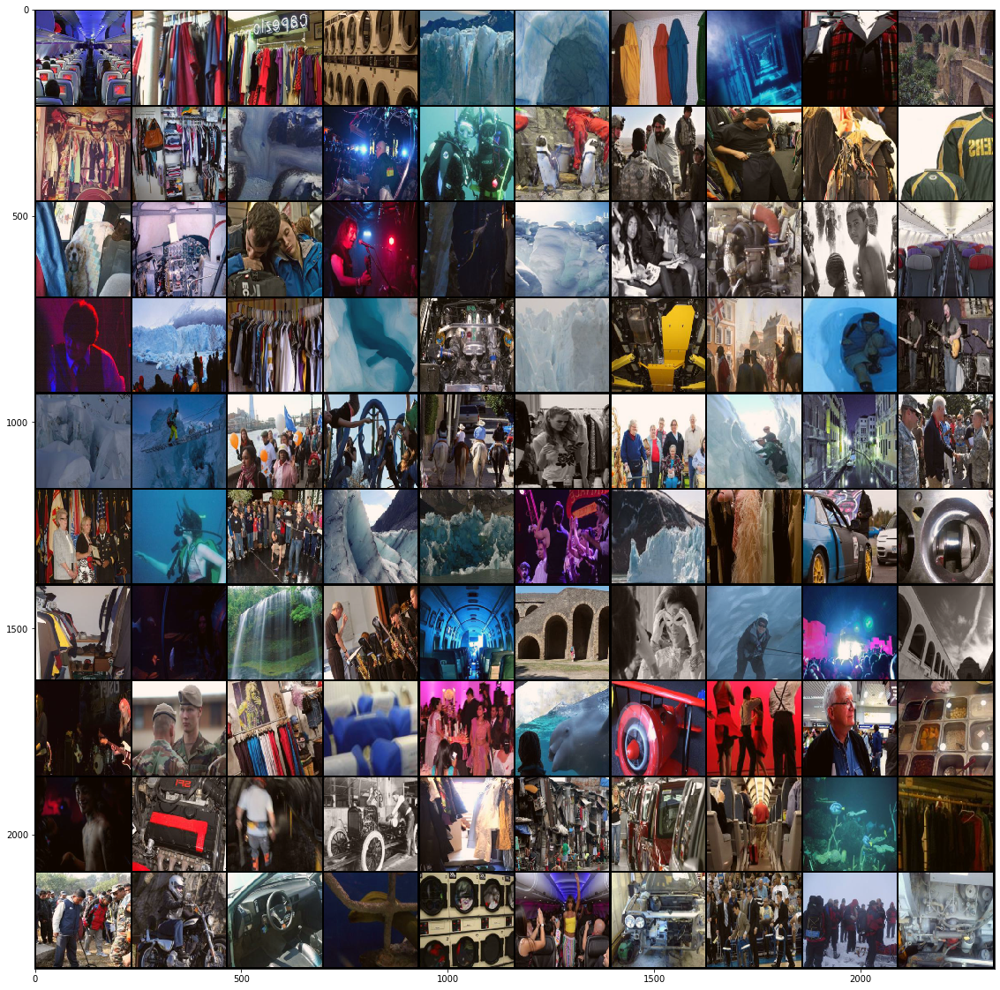

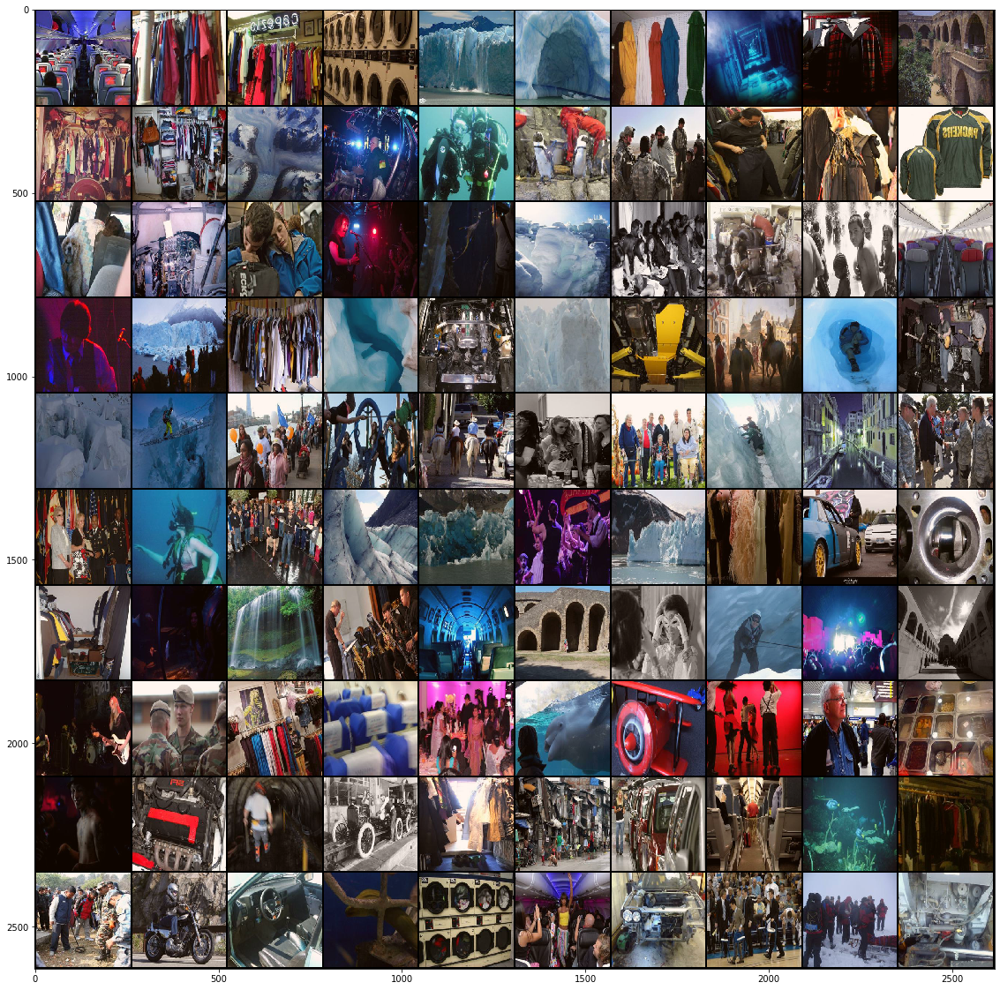

In [59]:
#orig_activations = maxact.harvest_activations(dnet.orig_net, place365_dataloader, {'conv': lambda m: m.features[10]})
maxact.visualize_neuron('conv', 178, dnet.orig_net, orig_activations, place365_dataset, with_lucent=False)

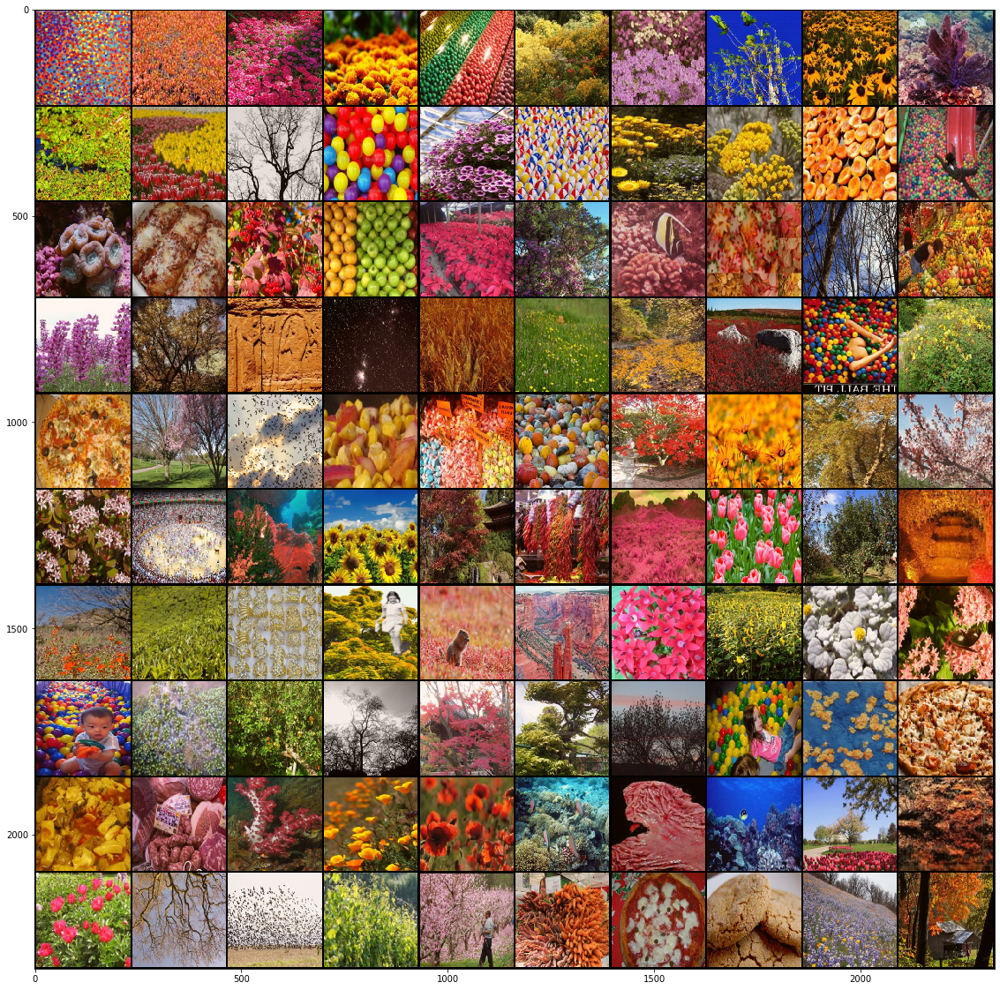

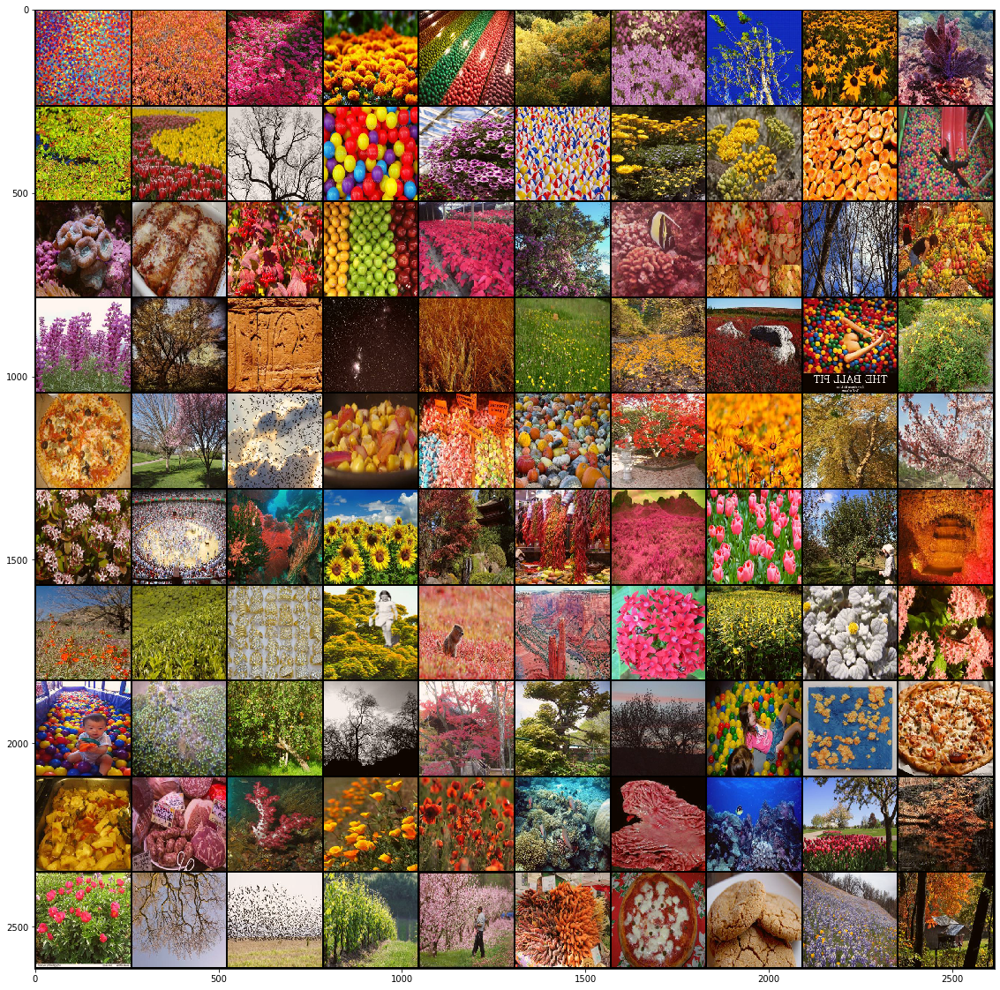

In [32]:
splitted_activations = maxact.harvest_activations(dnet.splitted_net, place365_dataloader, {'conv': lambda m: m.features[10]})
maxact.visualize_neuron('conv', NEURON, dnet.splitted_net, splitted_activations, place365_dataset, with_lucent=False)

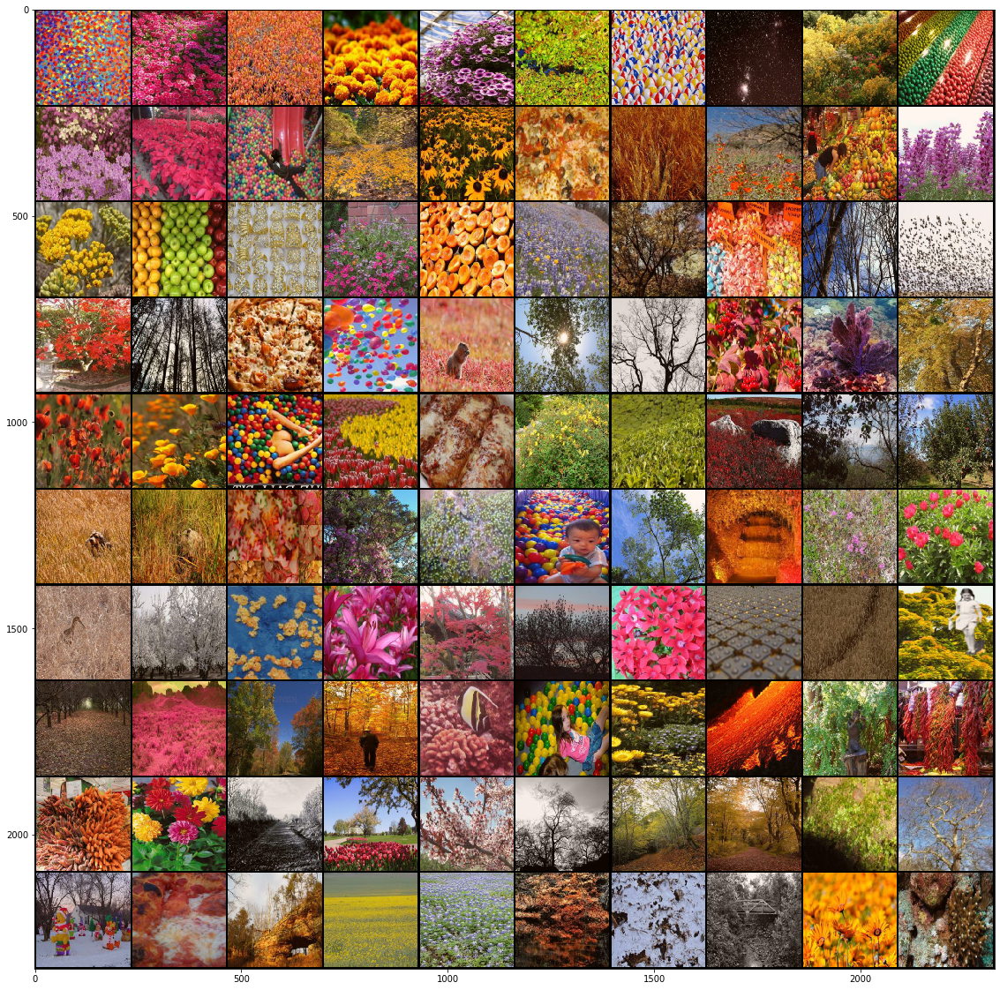

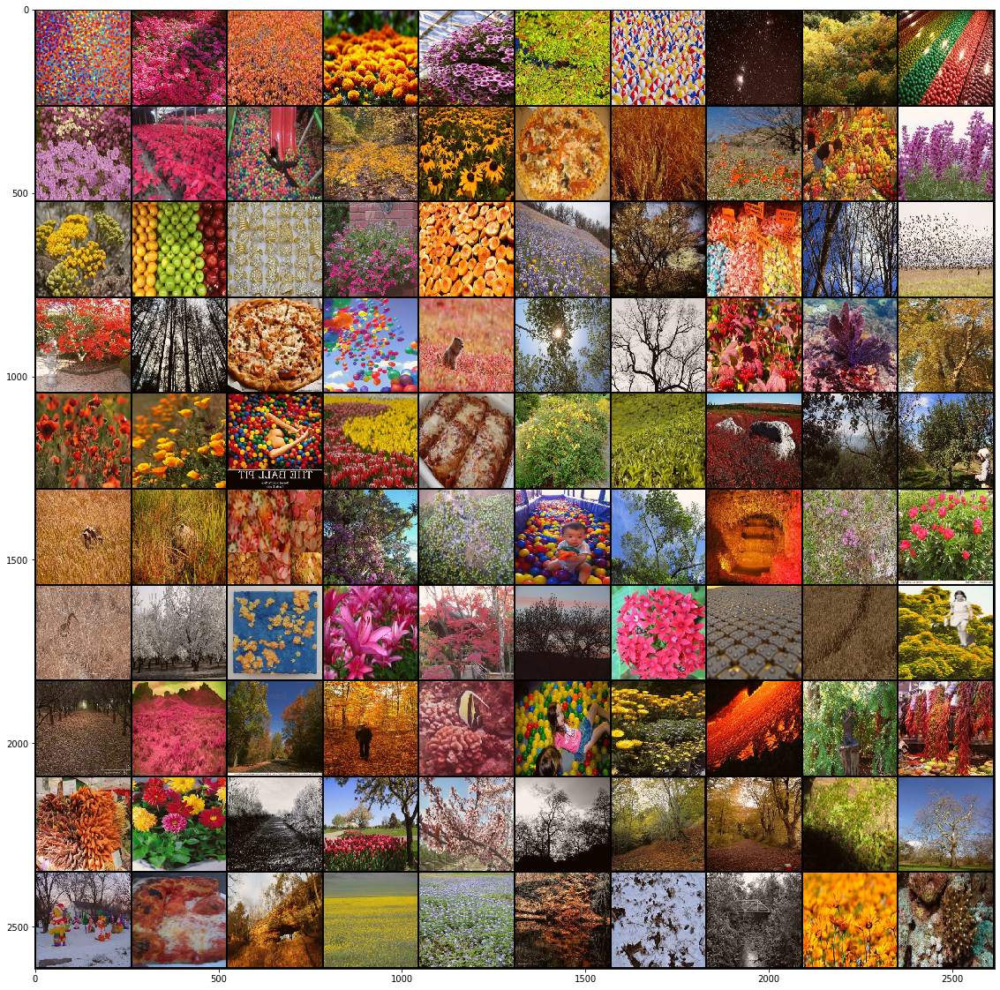

In [31]:
maxact.visualize_neuron('conv', -1, model, splitted_activations, place365_dataset, with_lucent=False)

# Dump

In [ ]:
df = pd.read_csv('../result/resnet18_places365_broden_ade20k_neuron_2/tally_layer4.csv')

In [ ]:
df.head()